In [1]:
# Opening libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from scipy.stats import zscore
from uszipcode import SearchEngine


import statsmodels.api as sm
from statsmodels.formula.api import ols
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from statsmodels.stats.outliers_influence import variance_inflation_factor
from uszipcode import SearchEngine
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error

In [2]:
# Opening main data file

df = pd.read_csv('data/kc_house_data.csv')

In [3]:
# Opening a Markdown file wich includes column names for our dataset

from IPython.display import Markdown

file_path = 'data/column_names.md'

with open(file_path, 'r') as file:
    file_contents = file.read()

Markdown(file_contents)

# Column Names and descriptions for Kings County Data Set
* **id** - unique identified for a house
* **dateDate** - house was sold
* **pricePrice** -  is prediction target
* **bedroomsNumber** -  of Bedrooms/House
* **bathroomsNumber** -  of bathrooms/bedrooms
* **sqft_livingsquare** -  footage of the home
* **sqft_lotsquare** -  footage of the lot
* **floorsTotal** -  floors (levels) in house
* **waterfront** - House which has a view to a waterfront
* **view** - Has been viewed
* **condition** - How good the condition is ( Overall )
* **grade** - overall grade given to the housing unit, based on King County grading system
* **sqft_above** - square footage of house apart from basement
* **sqft_basement** - square footage of the basement
* **yr_built** - Built Year
* **yr_renovated** - Year when house was renovated
* **zipcode** - zip
* **lat** - Latitude coordinate
* **long** - Longitude coordinate
* **sqft_living15** - The square footage of interior housing living space for the nearest 15 neighbors
* **sqft_lot15** - The square footage of the land lots of the nearest 15 neighbors


In [4]:
df.shape

(21597, 21)

In [5]:
df

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900,3,1.00,1180,5650,1.0,NaN,0.0,...,7,1180,0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/09/2014,538000,3,2.25,2570,7242,2.0,0.0,0.0,...,7,2170,400,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000,2,1.00,770,10000,1.0,0.0,0.0,...,6,770,0,1933,NaN,98028,47.7379,-122.233,2720,8062
3,2487200875,12/09/2014,604000,4,3.00,1960,5000,1.0,0.0,0.0,...,7,1050,910,1965,0.0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000,3,2.00,1680,8080,1.0,0.0,0.0,...,8,1680,0,1987,0.0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,5/21/2014,360000,3,2.50,1530,1131,3.0,0.0,0.0,...,8,1530,0,2009,0.0,98103,47.6993,-122.346,1530,1509
21593,6600060120,2/23/2015,400000,4,2.50,2310,5813,2.0,0.0,0.0,...,8,2310,0,2014,0.0,98146,47.5107,-122.362,1830,7200
21594,1523300141,6/23/2014,402101,2,0.75,1020,1350,2.0,0.0,0.0,...,7,1020,0,2009,0.0,98144,47.5944,-122.299,1020,2007
21595,291310100,1/16/2015,400000,3,2.50,1600,2388,2.0,NaN,0.0,...,8,1600,0,2004,0.0,98027,47.5345,-122.069,1410,1287


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  int64  
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     19221 non-null  float64
 9   view           21534 non-null  float64
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  object 
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17755 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

In [7]:
# Checking if there any Nulls in the dataset

pd.isnull(df).any()

id               False
date             False
price            False
bedrooms         False
bathrooms        False
sqft_living      False
sqft_lot         False
floors           False
waterfront        True
view              True
condition        False
grade            False
sqft_above       False
sqft_basement    False
yr_built         False
yr_renovated      True
zipcode          False
lat              False
long             False
sqft_living15    False
sqft_lot15       False
dtype: bool

In [8]:
# Replacing n/a values

df_filled_na = df.fillna(0)

In [9]:
# Since we saw that there are numbers in the sqft_basement column, but the data type is object, we should check all the values in that column to see what makes the number column object type
# As a resuly, we can see "?" being in the column. Let's get rid of it
distinct_sqft_basement = df['sqft_basement'].unique()
distinct_sqft_basement

array(['0', '400', '910', '1530', '?', '730', '1700', '300', '970', '760',
       '720', '700', '820', '780', '790', '330', '1620', '360', '588',
       '1510', '410', '990', '600', '560', '550', '1000', '1600', '500',
       '1040', '880', '1010', '240', '265', '290', '800', '540', '710',
       '840', '380', '770', '480', '570', '1490', '620', '1250', '1270',
       '120', '650', '180', '1130', '450', '1640', '1460', '1020', '1030',
       '750', '640', '1070', '490', '1310', '630', '2000', '390', '430',
       '850', '210', '1430', '1950', '440', '220', '1160', '860', '580',
       '2060', '1820', '1180', '200', '1150', '1200', '680', '530',
       '1450', '1170', '1080', '960', '280', '870', '1100', '460', '1400',
       '660', '1220', '900', '420', '1580', '1380', '475', '690', '270',
       '350', '935', '1370', '980', '1470', '160', '950', '50', '740',
       '1780', '1900', '340', '470', '370', '140', '1760', '130', '520',
       '890', '1110', '150', '1720', '810', '190', '129

In [10]:
# Replaced '?' with 0

df_replace_qm = df_filled_na.replace('?',0)

In [11]:
# Changing type for sqft_basement

df_replace_qm['sqft_basement'] = df_replace_qm['sqft_basement'].astype(int)

In [12]:
# Changing type for date column

df_replace_qm ["date"] = pd.to_datetime(df_replace_qm["date"])

In [101]:
# Creating a new column for year of sale only

df_replace_qm['yr_of_sale'] = df_replace_qm['date'].dt.year

In [14]:
yr_of_sale_dist = df_replace_qm['yr_of_sale'].unique()
yr_of_sale_dist

array([2014, 2015])

In [15]:
# Creating a new column called propery_age

df_replace_qm['property_age'] = df_replace_qm['yr_of_sale'] - df_replace_qm['yr_built']
df_replace_qm.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,yr_of_sale,property_age
0,7129300520,2014-10-13,221900,3,1.00,1180,5650,1.0,0.0,0.0,...,0,1955,0.0,98178,47.5112,-122.257,1340,5650,2014,59
1,6414100192,2014-12-09,538000,3,2.25,2570,7242,2.0,0.0,0.0,...,400,1951,1991.0,98125,47.7210,-122.319,1690,7639,2014,63
2,5631500400,2015-02-25,180000,2,1.00,770,10000,1.0,0.0,0.0,...,0,1933,0.0,98028,47.7379,-122.233,2720,8062,2015,82
3,2487200875,2014-12-09,604000,4,3.00,1960,5000,1.0,0.0,0.0,...,910,1965,0.0,98136,47.5208,-122.393,1360,5000,2014,49
4,1954400510,2015-02-18,510000,3,2.00,1680,8080,1.0,0.0,0.0,...,0,1987,0.0,98074,47.6168,-122.045,1800,7503,2015,28


In [16]:
# We are looking at the if there are any negative values in the newly created property_age column. We can see that the year built is 2015 and the year of sale is 2014. This might be a data input error. Thus, we are not going to remove the rows but will replace -1 with 0

age_negative_values = df_replace_qm[df_replace_qm['property_age'] < 0]
age_negative_values

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,yr_of_sale,property_age
1761,1832100030,2014-06-25,597326,4,4.00,3570,8250,2.0,0.0,0.0,...,710,2015,0.0,98040,47.5784,-122.226,2230,10000,2014,-1
2685,3076500830,2014-10-29,385195,1,1.00,710,6000,1.5,0.0,0.0,...,0,2015,0.0,98144,47.5756,-122.316,1440,4800,2014,-1
7519,9520900210,2014-12-31,614285,5,2.75,2730,6401,2.0,0.0,0.0,...,0,2015,0.0,98072,47.7685,-122.160,2520,6126,2014,-1
8032,1250200495,2014-06-24,455000,2,1.50,1200,1259,2.0,0.0,0.0,...,200,2015,0.0,98144,47.6001,-122.298,1320,1852,2014,-1
14475,2770601530,2014-08-26,500000,2,2.25,1570,1269,2.0,0.0,0.0,...,290,2015,0.0,98199,47.6514,-122.385,1570,6000,2014,-1
17084,9126100346,2014-06-17,350000,3,2.00,1380,3600,3.0,0.0,0.0,...,0,2015,0.0,98122,47.6074,-122.305,1480,3600,2014,-1
19789,9126100765,2014-08-01,455000,3,1.75,1320,1014,3.0,0.0,0.0,...,0,2015,0.0,98122,47.6047,-122.305,1380,1495,2014,-1
20754,9310300160,2014-08-28,357000,5,2.50,2990,9240,2.0,0.0,0.0,...,0,2015,0.0,98133,47.7384,-122.348,1970,18110,2014,-1
20836,1257201420,2014-07-09,595000,4,3.25,3730,4560,2.0,0.0,0.0,...,970,2015,0.0,98103,47.6725,-122.330,1800,4560,2014,-1
20947,6058600220,2014-07-31,230000,3,1.50,1040,1264,2.0,0.0,0.0,...,140,2015,0.0,98144,47.5951,-122.301,1350,3000,2014,-1


In [17]:
# Cleaning df from those negative and zero rows. We will leave 0 in the data since the sale might be in the same year but different month, however the the year variance shows 0

df_clean_data = df_replace_qm[df_replace_qm['property_age']  >= 0]
df_clean_data

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,yr_of_sale,property_age
0,7129300520,2014-10-13,221900,3,1.00,1180,5650,1.0,0.0,0.0,...,0,1955,0.0,98178,47.5112,-122.257,1340,5650,2014,59
1,6414100192,2014-12-09,538000,3,2.25,2570,7242,2.0,0.0,0.0,...,400,1951,1991.0,98125,47.7210,-122.319,1690,7639,2014,63
2,5631500400,2015-02-25,180000,2,1.00,770,10000,1.0,0.0,0.0,...,0,1933,0.0,98028,47.7379,-122.233,2720,8062,2015,82
3,2487200875,2014-12-09,604000,4,3.00,1960,5000,1.0,0.0,0.0,...,910,1965,0.0,98136,47.5208,-122.393,1360,5000,2014,49
4,1954400510,2015-02-18,510000,3,2.00,1680,8080,1.0,0.0,0.0,...,0,1987,0.0,98074,47.6168,-122.045,1800,7503,2015,28
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,2014-05-21,360000,3,2.50,1530,1131,3.0,0.0,0.0,...,0,2009,0.0,98103,47.6993,-122.346,1530,1509,2014,5
21593,6600060120,2015-02-23,400000,4,2.50,2310,5813,2.0,0.0,0.0,...,0,2014,0.0,98146,47.5107,-122.362,1830,7200,2015,1
21594,1523300141,2014-06-23,402101,2,0.75,1020,1350,2.0,0.0,0.0,...,0,2009,0.0,98144,47.5944,-122.299,1020,2007,2014,5
21595,291310100,2015-01-16,400000,3,2.50,1600,2388,2.0,0.0,0.0,...,0,2004,0.0,98027,47.5345,-122.069,1410,1287,2015,11


In [18]:
# Used this option to suppress the copy on write warning message

pd.options.mode.copy_on_write = True

In [19]:
# Now we replace 0 years with the 1 since it explains the property age better

df_clean_data['property_age'] = df_clean_data['property_age'].replace(0, 1)

In [20]:
# Looking at the data structure

df_clean_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 21585 entries, 0 to 21596
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             21585 non-null  int64         
 1   date           21585 non-null  datetime64[ns]
 2   price          21585 non-null  int64         
 3   bedrooms       21585 non-null  int64         
 4   bathrooms      21585 non-null  float64       
 5   sqft_living    21585 non-null  int64         
 6   sqft_lot       21585 non-null  int64         
 7   floors         21585 non-null  float64       
 8   waterfront     21585 non-null  float64       
 9   view           21585 non-null  float64       
 10  condition      21585 non-null  int64         
 11  grade          21585 non-null  int64         
 12  sqft_above     21585 non-null  int64         
 13  sqft_basement  21585 non-null  int32         
 14  yr_built       21585 non-null  int64         
 15  yr_renovated   21585 non

In [21]:
# We can see that waterfront column has 21155  however a lot of values are zero. Let's have a look how many rows have values higher than zero.

waterfront_count = (df_clean_data['waterfront'] > 0).sum()
waterfront_count

146

In [22]:
# It has values 0 and 1, which means if the porerty near water is 1, and if not, then 0

waterfront_view = df_clean_data['waterfront'].unique()
waterfront_view

array([0., 1.])

In [23]:
# Renaming df for simplicity, more data cleansigng anticipated

data = df_clean_data

In [24]:
data.describe()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,yr_of_sale,property_age
count,2.158500e+04,21585,2.158500e+04,21585.000000,21585.000000,21585.000000,2.158500e+04,21585.000000,21585.000000,21585.000000,...,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000
mean,4.580000e+09,2014-10-29 05:19:13.300903424,5.403381e+05,3.373268,2.115659,2080.257633,1.510564e+04,1.493653,0.006764,0.233218,...,285.754505,1970.975214,68.796433,98077.928237,47.560048,-122.213931,1986.742599,12762.282835,2014.323141,43.367848
min,1.000102e+06,2014-05-02 00:00:00,7.800000e+04,1.000000,0.500000,370.000000,5.200000e+02,1.000000,0.000000,0.000000,...,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000,2014.000000,1.000000
25%,2.123049e+09,2014-07-22 00:00:00,3.220000e+05,3.000000,1.750000,1430.000000,5.043000e+03,1.000000,0.000000,0.000000,...,0.000000,1951.000000,0.000000,98033.000000,47.470900,-122.328000,1490.000000,5100.000000,2014.000000,18.000000
50%,3.904930e+09,2014-10-16 00:00:00,4.500000e+05,3.000000,2.250000,1910.000000,7.620000e+03,1.500000,0.000000,0.000000,...,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000,2014.000000,40.000000
75%,7.308900e+09,2015-02-17 00:00:00,6.450000e+05,4.000000,2.500000,2550.000000,1.068900e+04,2.000000,0.000000,0.000000,...,550.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000,2015.000000,63.000000
max,9.900000e+09,2015-05-27 00:00:00,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,...,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000,2015.000000,115.000000
std,2.876494e+09,NaN,3.674563e+05,0.926045,0.768889,917.929808,4.142325e+04,0.539366,0.081967,0.764772,...,439.880628,29.365067,364.135070,53.511032,0.138570,0.140738,685.329922,27281.301297,0.467687,29.337761


In [25]:

# Let's visualise location of our property on the map using lat and long columns. We will also visiualise price of the property based on location

# Initialize the map centered around an average location
center_lat, center_long = data['lat'].mean(), data['long'].mean()
map = folium.Map(location=[center_lat, center_long], zoom_start=10, tiles='OpenStreetMap')

# Function to determine color based on price
def price_color(price):
    if price > 1500000:
        return 'red'
    elif price > 645000:
        return 'orange'
    else:
        return 'green'

# Add points to the map
for idx, row in data.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=5, 
        color=price_color(row['price']),
        fill=True,
        fill_color=price_color(row['price']),
        fill_opacity=0.7,
        popup=f"Price: ${row['price']:,}"
    ).add_to(map)

map  

 # We can tell that the most expensive properties are located around Lake Washington around Bellevue, Medina, Seattle and Mercer Island.
 # This is also linked to our waterfront values 

In [26]:
# Looking at the most expensive properties on the map

high_price_threshold = 1500000  # Houses priced above $1,500,000

# Calculate the center of the map
center_lat, center_long = data['lat'].mean(), data['long'].mean()
map = folium.Map(location=[center_lat, center_long], zoom_start=10, tiles='OpenStreetMap')

# Function to determine color based on price
def price_color(price):
    return 'red'  

# Add points to the map for only the houses above the specified price threshold
for idx, row in data.iterrows():
    if row['price'] > high_price_threshold:
        folium.CircleMarker(
            location=[row['lat'], row['long']],
            radius=5,  
            color=price_color(row['price']),
            fill=True,
            fill_color=price_color(row['price']),
            fill_opacity=0.7,
            popup=f"Price: ${row['price']:,}"
        ).add_to(map)


map

In [27]:
# Creating a new column for sqft basement if there is a basement or not, , where 0 - no, 1 - yes. we want to make this column categorecal value

data['has_basement'] = np.where(data['sqft_basement'] > 0, '1', '0').astype(int)

In [28]:
# Looking at what are the disctinct values for view column

view_view = data['view'].unique()
view_view

array([0., 3., 4., 2., 1.])

In [29]:
# Looking at how many records are for view column.  2111 is not substantial for our model so we can remove it

view_count = (data['view'] > 0).sum()
view_count

2111

In [30]:
# Looking at how many records are for yr_renovated column. 744 is not substantial for our model so we can remove it

yr_renovated_count = (data['yr_renovated'] > 0).sum()
yr_renovated_count

744

In [31]:
# Dropping variables we do not consider in this model

data = data.drop(['id', 'date',  'yr_of_sale', 'yr_built','yr_renovated', 'lat', 'long', 'sqft_basement', 'view'], axis = 1)

In [32]:
column_names = data.columns
column_names

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'condition', 'grade', 'sqft_above', 'zipcode',
       'sqft_living15', 'sqft_lot15', 'property_age', 'has_basement'],
      dtype='object')

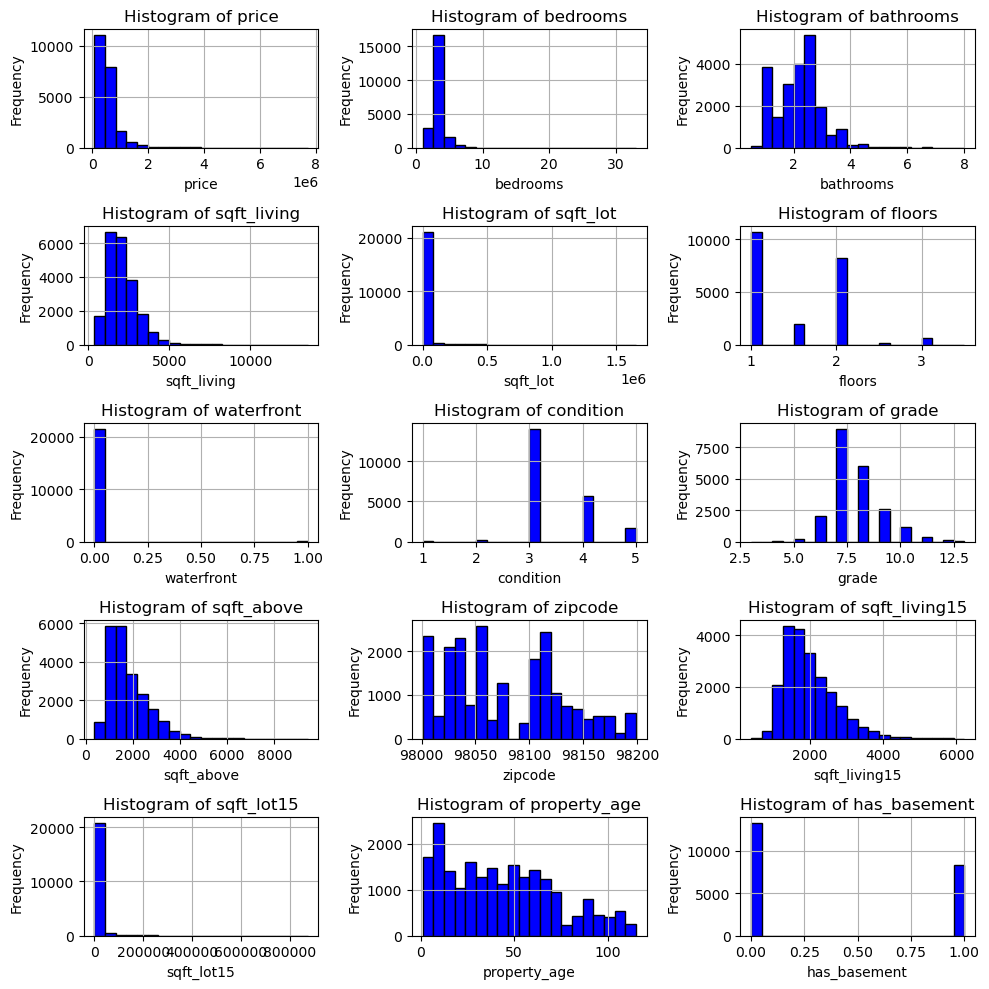

In [33]:
# Buiding a histogram to look at the distribution

variables = ['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'condition', 'grade', 'sqft_above', 'zipcode',
       'sqft_living15', 'sqft_lot15', 'property_age', 'has_basement']


fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(10, 10))


axes = axes.flatten()


for i, var in enumerate(variables):
    axes[i].hist(data[var], bins=20, color='blue', edgecolor='black')
    axes[i].set_title(f'Histogram of {var}')
    axes[i].set_xlabel(var)
    axes[i].set_ylabel('Frequency')
    axes[i].grid(True)


plt.tight_layout()
plt.show()

<Figure size 1200x600 with 0 Axes>

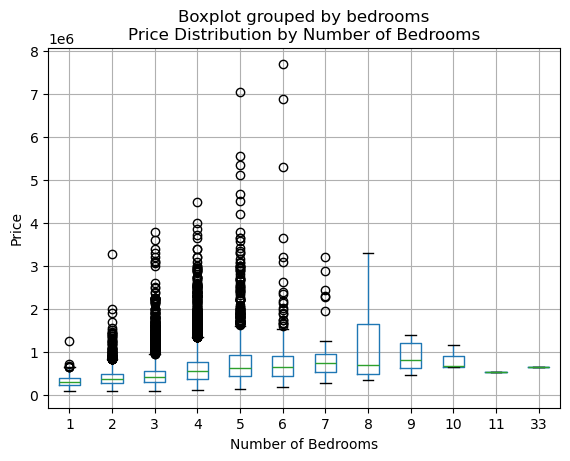

In [34]:
# Let's have a look at the box plot for bedrooms vs price
# We can definetly get rid of outliers and leave number of bedrooms in the range from 1 to 6


plt.figure(figsize=(12, 6)) 
data.boxplot(column='price', by='bedrooms')
plt.title('Price Distribution by Number of Bedrooms')
plt.xlabel('Number of Bedrooms')  
plt.ylabel('Price') 
plt.grid(True)
plt.show() 

<Figure size 1000x1000 with 0 Axes>

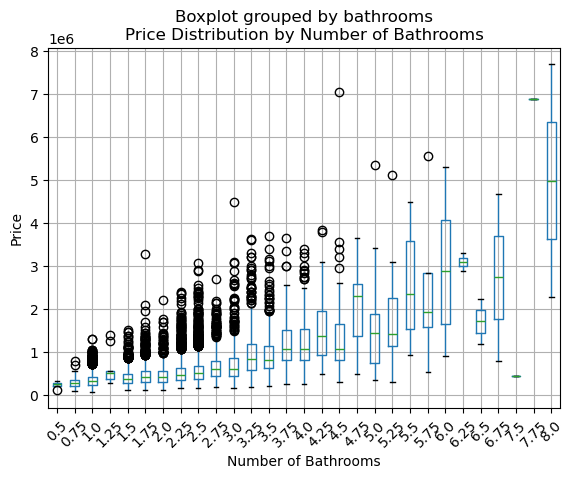

In [35]:
# Let's have a look at the box plot for bathrooms vs price
# We can definetly get rid of outliers and leave number of bathrooms in the range of 0.5 to 4.25


plt.figure(figsize=(10, 10)) 
data.boxplot(column='price', by='bathrooms')
plt.title('Price Distribution by Number of Bathrooms')
plt.xlabel('Number of Bathrooms')  
plt.ylabel('Price') 
plt.grid(True)

plt.xticks(rotation=45)  

plt.show()

In [36]:
data.describe()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,sqft_above,zipcode,sqft_living15,sqft_lot15,property_age,has_basement
count,2.158500e+04,21585.000000,21585.000000,21585.000000,2.158500e+04,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000,21585.000000
mean,5.403381e+05,3.373268,2.115659,2080.257633,1.510564e+04,1.493653,0.006764,3.410053,7.657447,1788.546027,98077.928237,1986.742599,12762.282835,43.367848,0.385036
std,3.674563e+05,0.926045,0.768889,917.929808,4.142325e+04,0.539366,0.081967,0.650655,1.173101,827.708387,53.511032,685.329922,27281.301297,29.337761,0.486615
min,7.800000e+04,1.000000,0.500000,370.000000,5.200000e+02,1.000000,0.000000,1.000000,3.000000,370.000000,98001.000000,399.000000,651.000000,1.000000,0.000000
25%,3.220000e+05,3.000000,1.750000,1430.000000,5.043000e+03,1.000000,0.000000,3.000000,7.000000,1190.000000,98033.000000,1490.000000,5100.000000,18.000000,0.000000
50%,4.500000e+05,3.000000,2.250000,1910.000000,7.620000e+03,1.500000,0.000000,3.000000,7.000000,1560.000000,98065.000000,1840.000000,7620.000000,40.000000,0.000000
75%,6.450000e+05,4.000000,2.500000,2550.000000,1.068900e+04,2.000000,0.000000,4.000000,8.000000,2210.000000,98118.000000,2360.000000,10083.000000,63.000000,1.000000
max,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,5.000000,13.000000,9410.000000,98199.000000,6210.000000,871200.000000,115.000000,1.000000


In [37]:
# Getting rid of outliers for bedrooms and bathrooms

# Calculate Z-scores for the bedrooms and bathrooms columns
data['zscore_bedrooms'] = zscore(data['bedrooms'])
data['zscore_bathrooms'] = zscore(data['bathrooms'])

# Define a threshold for Z-scores (commonly set to 3)
threshold = 3

# Filter out outliers based on the threshold
clean_data = data[(abs(data['zscore_bedrooms']) <= threshold) & (abs(data['zscore_bathrooms']) <= threshold)]


clean_data = clean_data.drop(columns=['zscore_bedrooms', 'zscore_bathrooms'])
clean_data.describe()


# Once we removed outliers our metrics for the entire data set have been adjusted. Say the max price was 7.7 million and became 4.49 million

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,sqft_above,zipcode,sqft_living15,sqft_lot15,property_age,has_basement
count,2.135100e+04,21351.000000,21351.000000,21351.000000,2.135100e+04,21351.00000,21351.000000,21351.00000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000
mean,5.291767e+05,3.347946,2.089129,2051.239193,1.491209e+04,1.48904,0.006182,3.41155,7.634771,1765.761651,98078.054096,1976.236148,12638.711067,43.484708,0.382699
std,3.296495e+05,0.865149,0.722327,861.595851,4.083445e+04,0.53847,0.078387,0.65138,1.144582,788.690370,53.517905,672.358025,26555.654863,29.307109,0.486057
min,7.800000e+04,1.000000,0.500000,370.000000,5.200000e+02,1.00000,0.000000,1.00000,3.000000,370.000000,98001.000000,399.000000,651.000000,1.000000,0.000000
25%,3.200000e+05,3.000000,1.500000,1420.000000,5.034000e+03,1.00000,0.000000,3.00000,7.000000,1190.000000,98033.000000,1480.000000,5100.000000,18.000000,0.000000
50%,4.500000e+05,3.000000,2.250000,1900.000000,7.590000e+03,1.50000,0.000000,3.00000,7.000000,1550.000000,98065.000000,1830.000000,7614.000000,40.000000,0.000000
75%,6.373750e+05,4.000000,2.500000,2520.000000,1.058450e+04,2.00000,0.000000,4.00000,8.000000,2190.000000,98118.000000,2350.000000,10042.000000,63.000000,1.000000
max,4.490000e+06,6.000000,4.250000,7850.000000,1.651359e+06,3.50000,1.000000,5.00000,13.000000,7850.000000,98199.000000,6210.000000,871200.000000,115.000000,1.000000


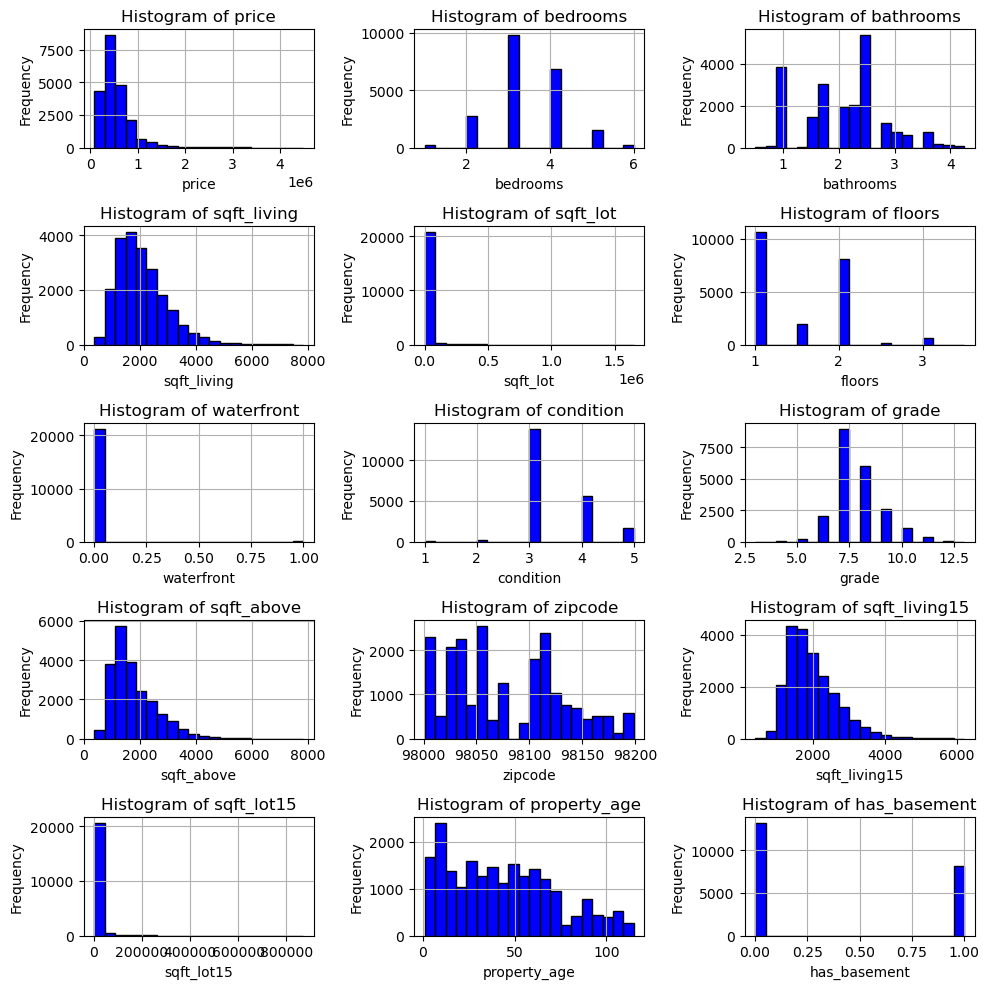

In [38]:
# Buiding a histogram to look at the distribution after we removed outliers for bedrooms and bathrooms. We can definitely see some inprovements in the distibution

variables = ['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'condition', 'grade', 'sqft_above', 'zipcode',
       'sqft_living15', 'sqft_lot15', 'property_age', 'has_basement']


fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(10, 10))


axes = axes.flatten()


for i, var in enumerate(variables):
    axes[i].hist(clean_data[var], bins=20, color='blue', edgecolor='black')
    axes[i].set_title(f'Histogram of {var}')
    axes[i].set_xlabel(var)
    axes[i].set_ylabel('Frequency')
    axes[i].grid(True)


plt.tight_layout()
plt.show()

In [39]:
clean_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 21351 entries, 0 to 21596
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   price          21351 non-null  int64  
 1   bedrooms       21351 non-null  int64  
 2   bathrooms      21351 non-null  float64
 3   sqft_living    21351 non-null  int64  
 4   sqft_lot       21351 non-null  int64  
 5   floors         21351 non-null  float64
 6   waterfront     21351 non-null  float64
 7   condition      21351 non-null  int64  
 8   grade          21351 non-null  int64  
 9   sqft_above     21351 non-null  int64  
 10  zipcode        21351 non-null  int64  
 11  sqft_living15  21351 non-null  int64  
 12  sqft_lot15     21351 non-null  int64  
 13  property_age   21351 non-null  int64  
 14  has_basement   21351 non-null  int32  
dtypes: float64(3), int32(1), int64(11)
memory usage: 2.5 MB


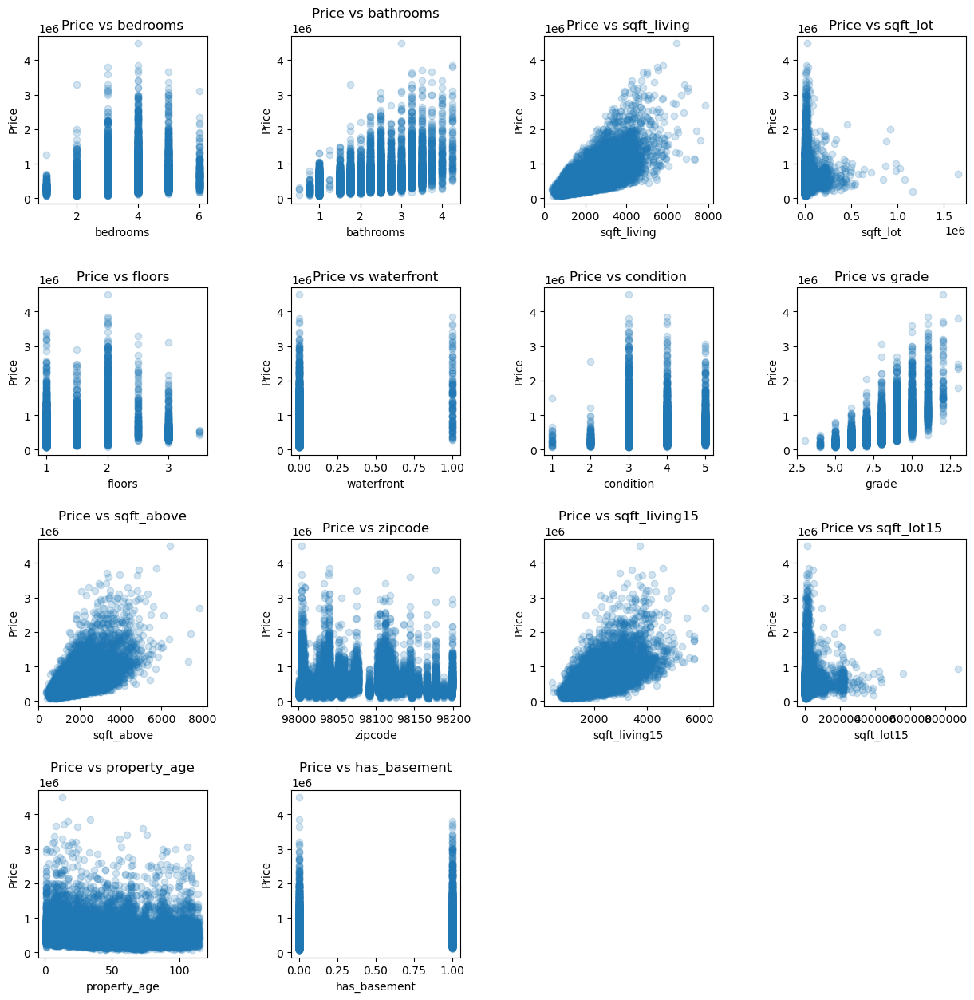

In [40]:
# Building a subplot scatter plot for each of the features listed in our dataset in relation to the price. This will allow us to visually examine how each feature correlates with the price

features = ['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
            'waterfront', 'condition', 'grade', 'sqft_above', 'zipcode',
            'sqft_living15', 'sqft_lot15', 'property_age', 'has_basement']


n_rows = 4
n_cols = 4

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 15))
fig.subplots_adjust(hspace=0.5, wspace=0.5)


for i, feature in enumerate(features):
    ax = axes[i // n_cols, i % n_cols]
    ax.scatter(clean_data[feature], clean_data['price'], alpha=0.2)
    ax.set_title(f'Price vs {feature}')
    ax.set_xlabel(feature)
    ax.set_ylabel('Price')


for j in range(i + 1, n_rows * n_cols):
    axes[j // n_cols, j % n_cols].axis('off')


plt.show()

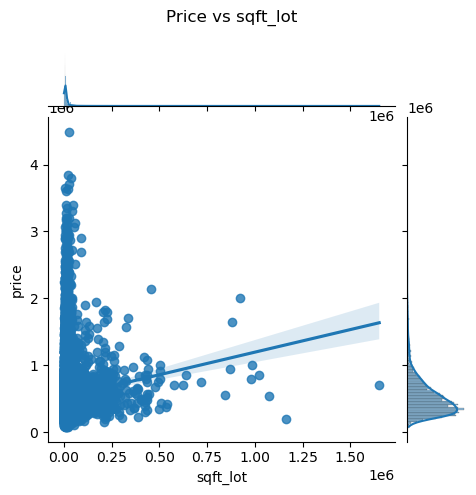

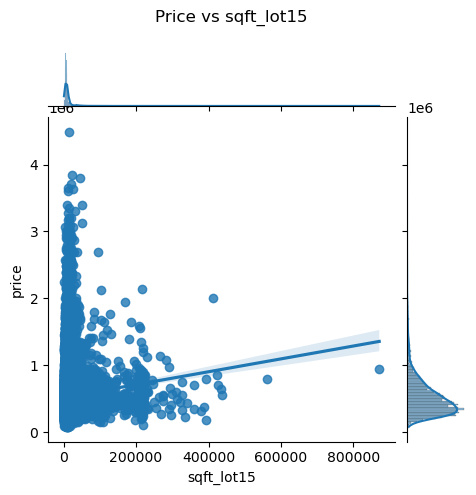

In [41]:
# So we can see there is a linear relation between pretty much all the variables and price, however sqft_lot and sqft_lot15 have a little strange picture. 
# You would consider that the bigger the lot the higher the price, however this is not that case in our dataset.
#  Let's check sqft_lot and sqft_lot15 for linearity assumption

cont_feat = ['sqft_lot',  'sqft_lot15']

for feature in cont_feat:
    g = sns.jointplot(x=clean_data[feature], y=clean_data['price'], kind='reg', height=5)  
    g.fig.suptitle(f'Price vs {feature}')  
    plt.subplots_adjust(top=0.9)  


In [42]:
# Both features appeared to be somewhat linear, we will keep them for now to decide later if they need to be in our model after correlation heatmap

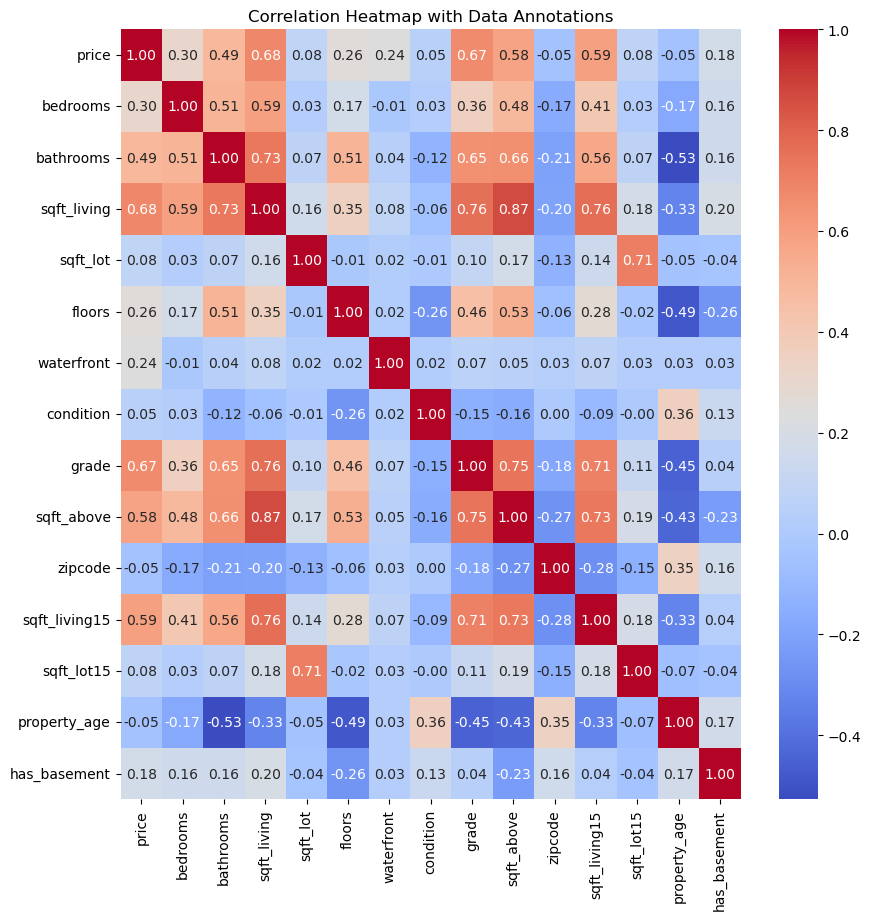

In [43]:
# Building a correlation heatmap

corr_matrix = clean_data.corr()


plt.figure(figsize=(10, 10))

sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm',annot_kws={"size": 10})
plt.title('Correlation Heatmap with Data Annotations')
plt.show()

In [44]:
# Now we are going to start the process of identifying variables which are strongly correlated with each other

In [45]:
#  Data prep - removing price column

data_pred = clean_data.iloc[:,1:]
data_pred.head()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,sqft_above,zipcode,sqft_living15,sqft_lot15,property_age,has_basement
0,3,1.00,1180,5650,1.0,0.0,3,7,1180,98178,1340,5650,59,0
1,3,2.25,2570,7242,2.0,0.0,3,7,2170,98125,1690,7639,63,1
2,2,1.00,770,10000,1.0,0.0,3,6,770,98028,2720,8062,82,0
3,4,3.00,1960,5000,1.0,0.0,5,7,1050,98136,1360,5000,49,1
4,3,2.00,1680,8080,1.0,0.0,3,8,1680,98074,1800,7503,28,0


In [46]:
data_pred.corr()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,sqft_above,zipcode,sqft_living15,sqft_lot15,property_age,has_basement
bedrooms,1.000000,0.509187,0.590255,0.030339,0.174383,-0.013074,0.028724,0.360962,0.482710,-0.165095,0.407148,0.029368,-0.169495,0.155930
bathrooms,0.509187,1.000000,0.732038,0.073726,0.510016,0.041349,-0.124951,0.653775,0.659621,-0.210055,0.563151,0.074926,-0.527463,0.155617
sqft_living,0.590255,0.732038,1.000000,0.162059,0.351802,0.081267,-0.055047,0.755437,0.866811,-0.203865,0.762733,0.176857,-0.326694,0.196776
sqft_lot,0.030339,0.073726,0.162059,1.000000,-0.009237,0.021789,-0.006636,0.104225,0.172217,-0.128708,0.141836,0.710701,-0.049209,-0.036588
floors,0.174383,0.510016,0.351802,-0.009237,1.000000,0.017696,-0.264232,0.456856,0.528751,-0.059861,0.275745,-0.015862,-0.491324,-0.259750
waterfront,-0.013074,0.041349,0.081267,0.021789,0.017696,1.000000,0.017132,0.069021,0.054427,0.034432,0.073461,0.032094,0.028565,0.032558
condition,0.028724,-0.124951,-0.055047,-0.006636,-0.264232,0.017132,1.000000,-0.145985,-0.159736,0.001408,-0.092005,-0.000385,0.358431,0.132438
grade,0.360962,0.653775,0.755437,0.104225,0.456856,0.069021,-0.145985,1.000000,0.746896,-0.184156,0.706767,0.112847,-0.450890,0.041615
sqft_above,0.482710,0.659621,0.866811,0.172217,0.528751,0.054427,-0.159736,0.746896,1.000000,-0.266866,0.733247,0.186707,-0.433633,-0.229941
zipcode,-0.165095,-0.210055,-0.203865,-0.128708,-0.059861,0.034432,0.001408,-0.184156,-0.266866,1.000000,-0.278355,-0.147840,0.347386,0.160980


In [47]:
# We want to see the boolian values for variables where correlation between the varibales is strong. 
# This we want to see all variables where correlation is over 0.75
abs(data_pred.corr()) > 0.70

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,sqft_above,zipcode,sqft_living15,sqft_lot15,property_age,has_basement
bedrooms,True,False,False,False,False,False,False,False,False,False,False,False,False,False
bathrooms,False,True,True,False,False,False,False,False,False,False,False,False,False,False
sqft_living,False,True,True,False,False,False,False,True,True,False,True,False,False,False
sqft_lot,False,False,False,True,False,False,False,False,False,False,False,True,False,False
floors,False,False,False,False,True,False,False,False,False,False,False,False,False,False
waterfront,False,False,False,False,False,True,False,False,False,False,False,False,False,False
condition,False,False,False,False,False,False,True,False,False,False,False,False,False,False
grade,False,False,True,False,False,False,False,True,True,False,True,False,False,False
sqft_above,False,False,True,False,False,False,False,True,True,False,True,False,False,False
zipcode,False,False,False,False,False,False,False,False,False,True,False,False,False,False


In [48]:
# Now we want to see the pairs of the variables that have a strong correlation
# save absolute value of correlation matrix as a data frame
# converts all values to absolute value
# stacks the row:column pairs into a multindex
# reset the index to set the multindex to seperate columns
# sort values. 0 is the column automatically generated by the stacking

df=data_pred.corr().abs().stack().reset_index().sort_values(0, ascending=False)

# zip the variable name columns (Which were only named level_0 and level_1 by default) in a new column named "pairs"
df['pairs'] = list(zip(df.level_0, df.level_1))

# set index to pairs
df.set_index(['pairs'], inplace = True)

#d rop level columns
df.drop(columns=['level_1', 'level_0'], inplace = True)

# rename correlation column as cc rather than 0
df.columns = ['cc']

# drop duplicates. 
df.drop_duplicates(inplace=True)


In [49]:
df[(df.cc>.70) & (df.cc <1)]

,cc
pairs,
"(sqft_living, sqft_above)",0.866811
"(sqft_living15, sqft_living)",0.762733
"(grade, sqft_living)",0.755437
"(grade, sqft_above)",0.746896
"(sqft_above, sqft_living15)",0.733247
"(sqft_living, bathrooms)",0.732038
"(sqft_lot, sqft_lot15)",0.710701
"(grade, sqft_living15)",0.706767


In [50]:
# We will remove sqft_above since it is sqft_living - basement. 
# We will leave sqft_living15 since we believe that sqft_living is more important for the observed houses than those of the neighbours
# We will remove sqft_lot15 since again we mostly care about our houses, not neighbours
# We can also see the correlation between grade and sqft_living which totally makes sence and we will explain it further
# Correlation between grade amd bathroom also makes sence, we will look at it later

In [51]:
# Dropping variables we do not consider in this model

clean_data = clean_data.drop(['sqft_living15','sqft_above', 'sqft_lot15'], axis = 1)

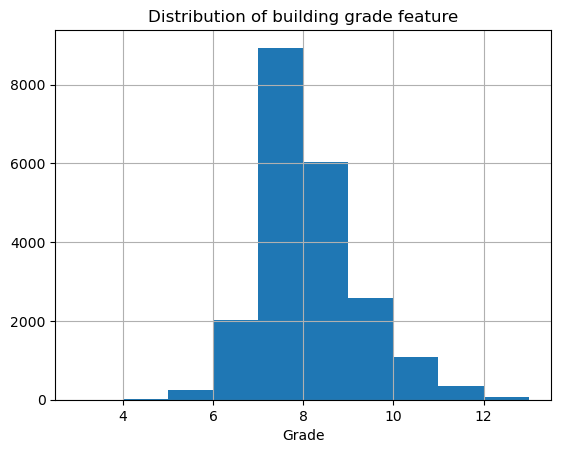

In [52]:
# Plot grade distribution. Grade seems to be normally distributed, whihc is good. 
# This is also a result of us removeing outliers for bedrroms and bathrooms

clean_data['grade'].hist()
plt.title('Distribution of building grade feature')
plt.xlabel('Grade')
plt.show()

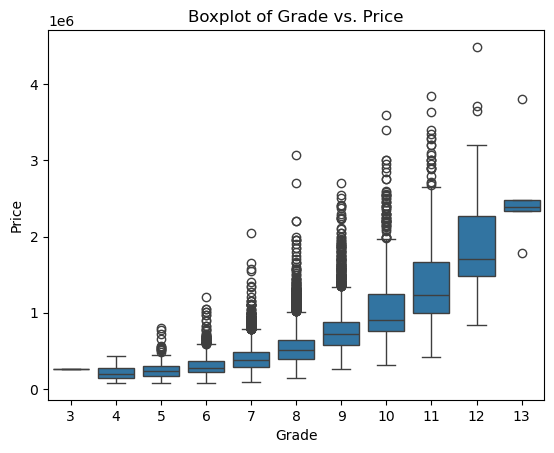

In [53]:
# Building the box plot to look at the median prices of the grade, and yes we can tell that grade is going to be a good predictor

sns.boxplot(x=clean_data['grade'], y=clean_data['price'])
plt.title("Boxplot of Grade vs. Price") 
plt.xlabel("Grade")  
plt.ylabel("Price")  
plt.show() 

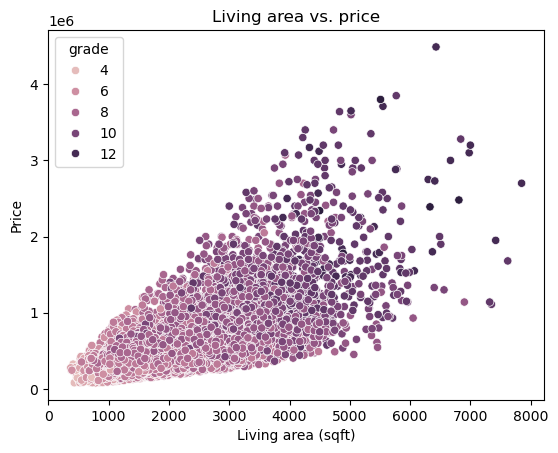

In [54]:
# Now we want to see how both sqft_living and grade both affect price, since we know thay are highly correlated and we need to decide if both of them are going to stay in the model
# Scatter plot of sqft living vs price with hue grade

sns.scatterplot(x = clean_data['sqft_living'], y = clean_data['price'], hue = clean_data['grade'], data = clean_data)
plt.title('Living area vs. price')
plt.xlabel('Living area (sqft)')
plt.ylabel('Price')
plt.show()


# We can see that there is a obvious relation between sqft_living and grade therefore we will leave both features in our model

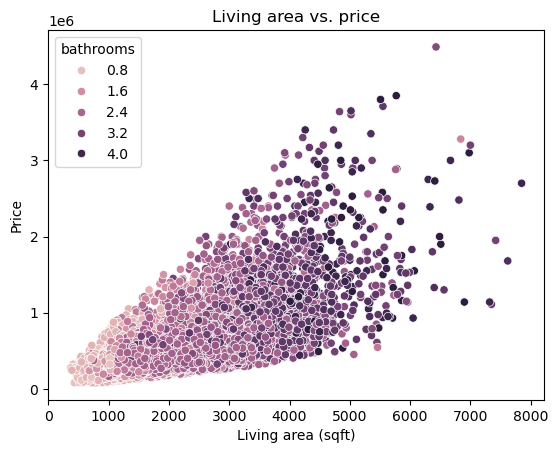

In [55]:
# Now we want to see how both sqft_living and bathrooms both affect price, since we know thay are highly correlated and we need to decide if both of them are going to stay in the model
# Scatter plot of sqft living vs price with hue bathroom

sns.scatterplot(x = clean_data['sqft_living'], y = clean_data['price'], hue = clean_data['bathrooms'], data = clean_data)
plt.title('Living area vs. price')
plt.xlabel('Living area (sqft)')
plt.ylabel('Price')
plt.show()


# and again we can see that there is a positive relation between sqft_living and athrooms therefore we will leave both features in our model

In [56]:
# Now that we aare sertain what features are going to be in our model, let's build out first OLS model
# Definig features

features_iteration_1 = clean_data.drop(['price'], axis = 1)
features_iteration_1.head()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,zipcode,property_age,has_basement
0,3,1.00,1180,5650,1.0,0.0,3,7,98178,59,0
1,3,2.25,2570,7242,2.0,0.0,3,7,98125,63,1
2,2,1.00,770,10000,1.0,0.0,3,6,98028,82,0
3,4,3.00,1960,5000,1.0,0.0,5,7,98136,49,1
4,3,2.00,1680,8080,1.0,0.0,3,8,98074,28,0


In [57]:
#  Defining predictor

predictor_interation_1 = clean_data['price']
predictor_interation_1.head()

0    221900
1    538000
2    180000
3    604000
4    510000
Name: price, dtype: int64

In [58]:
# Building the first OLS model

import statsmodels.api as sm


X_1 = features_iteration_1
y_1 = predictor_interation_1


X_1 = sm.add_constant(X_1)


model = sm.OLS(y_1, X_1).fit()


print(model.summary())


# R-squared is 0.633 whihc is not bad, the only P-value which is highr than 0.05 is ZIPcode, whihc makes sence. Let's try to do somthing about it and see how the model changed

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.633
Model:                            OLS   Adj. R-squared:                  0.633
Method:                 Least Squares   F-statistic:                     3349.
Date:                Mon, 13 May 2024   Prob (F-statistic):               0.00
Time:                        19:02:57   Log-Likelihood:            -2.9087e+05
No. Observations:               21351   AIC:                         5.818e+05
Df Residuals:                   21339   BIC:                         5.819e+05
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const        -1.005e+06   2.82e+06     -0.356   

In [59]:
# Now we want to replace zipcodes with the actual cities, since zipcode is not quite informative value

# Create a search engine object from uszipcode
search = SearchEngine()

# Function to get city name from zip code
def get_city_by_zip(zip_code):
    result = search.by_zipcode(zip_code)
    return result.major_city


clean_data['city'] = clean_data['zipcode'].apply(get_city_by_zip)

clean_data.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,condition,grade,zipcode,property_age,has_basement,city
0,221900,3,1.00,1180,5650,1.0,0.0,3,7,98178,59,0,Seattle
1,538000,3,2.25,2570,7242,2.0,0.0,3,7,98125,63,1,Seattle
2,180000,2,1.00,770,10000,1.0,0.0,3,6,98028,82,0,Kenmore
3,604000,4,3.00,1960,5000,1.0,0.0,5,7,98136,49,1,Seattle
4,510000,3,2.00,1680,8080,1.0,0.0,3,8,98074,28,0,Sammamish


In [60]:
# Now we can see all the cities instead of the zipcode which is more handy

distinct_cities = clean_data['city'].unique()
distinct_cities

array(['Seattle', 'Kenmore', 'Sammamish', 'Federal Way', 'Maple Valley',
       'Bellevue', 'Duvall', 'Auburn', 'Mercer Island', 'Kent', 'Redmond',
       'Issaquah', 'Renton', 'Vashon', 'Kirkland', 'Black Diamond',
       'North Bend', 'Woodinville', 'Snoqualmie', 'Enumclaw', 'Fall City',
       'Bothell', 'Carnation', 'Medina'], dtype=object)

In [61]:
# Dropping zipcode from our df

clean_data.drop(['zipcode'], axis = 1, inplace = True)

In [62]:
# Looking at the number of distinct values for categorical values bedrooms, bathrooms, floors, condition, grade and city

clean_data[['bedrooms', 'bathrooms', 'floors', 'grade', 'condition', 'city']].nunique()

bedrooms      6
bathrooms    16
floors        6
grade        11
condition     5
city         24
dtype: int64

In [63]:
# Creating dummy variables and dropping the first variable to avoid multicollinearity

bedrooms_dummies = pd.get_dummies(clean_data['bedrooms'], prefix='bed', drop_first=True).astype(int)
bathrooms_dummies = pd.get_dummies(clean_data['bathrooms'], prefix='bath', drop_first=True).astype(int)
floors_dummies = pd.get_dummies(clean_data['floors'], prefix='floor', drop_first=True).astype(int)
grade_dummies = pd.get_dummies(clean_data['grade'], prefix='grade', drop_first=True).astype(int)
condition_dummies = pd.get_dummies(clean_data['condition'], prefix='cond', drop_first=True).astype(int)
city_dummies = pd.get_dummies(clean_data['city'], prefix='city', drop_first=True).astype(int)

In [64]:
# Removing original columns from our data and replacing with dummy columns instead

clean_data = clean_data.drop(['bedrooms', 'bathrooms', 'floors', 'grade', 'condition', 'city'], axis=1)

In [65]:
# Replacing original values with dummy values

clean_data = pd.concat([clean_data, bedrooms_dummies, bathrooms_dummies, floors_dummies, grade_dummies, condition_dummies, city_dummies], axis=1)
clean_data.head()

,price,sqft_living,sqft_lot,waterfront,property_age,has_basement,bed_2,bed_3,bed_4,bed_5,...,city_Medina,city_Mercer Island,city_North Bend,city_Redmond,city_Renton,city_Sammamish,city_Seattle,city_Snoqualmie,city_Vashon,city_Woodinville
0,221900,1180,5650,0.0,59,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
1,538000,2570,7242,0.0,63,1,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
2,180000,770,10000,0.0,82,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,604000,1960,5000,0.0,49,1,0,0,1,0,...,0,0,0,0,0,0,1,0,0,0
4,510000,1680,8080,0.0,28,0,0,1,0,0,...,0,0,0,0,0,1,0,0,0,0


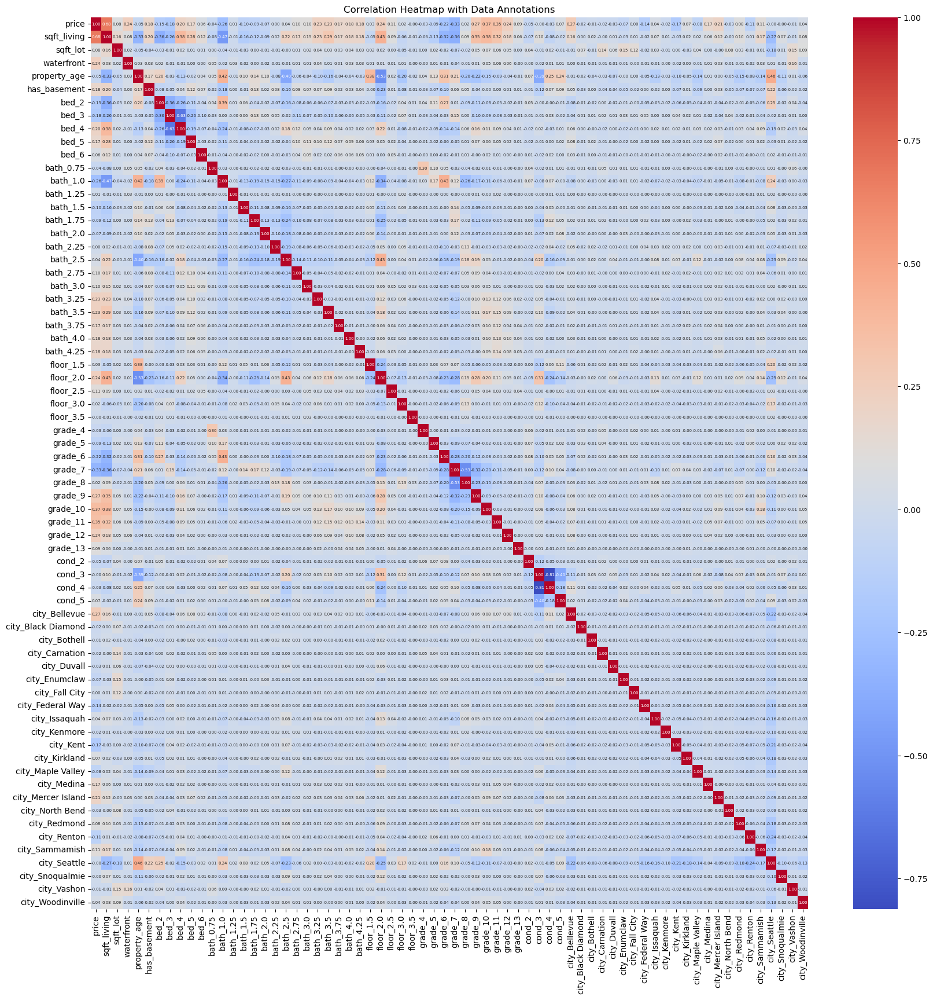

In [66]:
# Building a correlation heatmap again to see on the correlation

corr_matrix = clean_data.corr()


plt.figure(figsize=(20, 20))

sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm',annot_kws={"size": 5})
plt.title('Correlation Heatmap with Data Annotations')
plt.show()

# Now that we implemented dummies grade and batrooms are no longer strongly correlated to the sqft_living

In [67]:
# Let's start indexing for clean_data df from scratch

data_reset = clean_data.reset_index(drop=True)
data_reset

,price,sqft_living,sqft_lot,waterfront,property_age,has_basement,bed_2,bed_3,bed_4,bed_5,...,city_Medina,city_Mercer Island,city_North Bend,city_Redmond,city_Renton,city_Sammamish,city_Seattle,city_Snoqualmie,city_Vashon,city_Woodinville
0,221900,1180,5650,0.0,59,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
1,538000,2570,7242,0.0,63,1,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
2,180000,770,10000,0.0,82,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,604000,1960,5000,0.0,49,1,0,0,1,0,...,0,0,0,0,0,0,1,0,0,0
4,510000,1680,8080,0.0,28,0,0,1,0,0,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21346,360000,1530,1131,0.0,5,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
21347,400000,2310,5813,0.0,1,0,0,0,1,0,...,0,0,0,0,0,0,1,0,0,0
21348,402101,1020,1350,0.0,5,0,1,0,0,0,...,0,0,0,0,0,0,1,0,0,0
21349,400000,1600,2388,0.0,11,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [68]:
# Now let's do some log transformation for our numerical variables sqft_living, sqft_lot, and property_age

data_normalisation = data_reset[['sqft_living', 'sqft_lot', 'property_age']]
data_normalisation.head()


,sqft_living,sqft_lot,property_age
0,1180,5650,59
1,2570,7242,63
2,770,10000,82
3,1960,5000,49
4,1680,8080,28


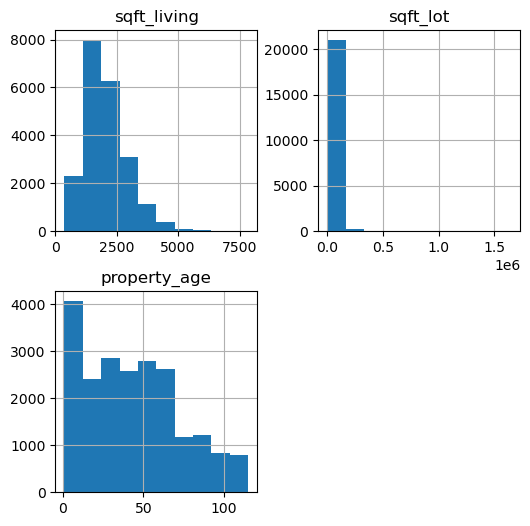

In [69]:
data_pred[['sqft_living', 'sqft_lot', 'property_age']].hist(figsize  = [6, 6]); 

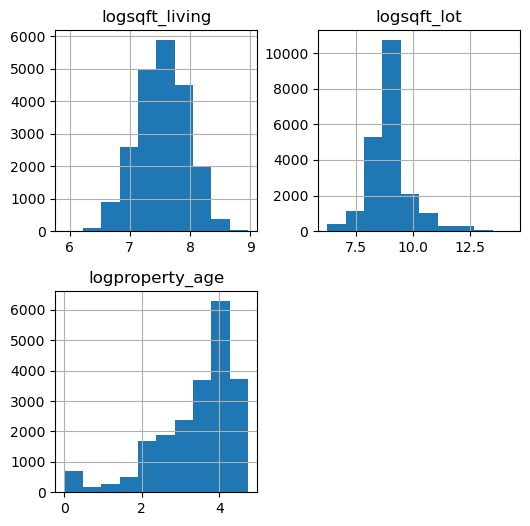

In [70]:
# Log transormation

data_log = pd.DataFrame([])
small_constant = 1e-6

# Functions to safely apply log transformation
def safe_log(column):
    # Add a small constant to zero or negative values
    adjusted_column = np.where(column <= 0, small_constant, column)
    return np.log(adjusted_column)

# Apply safe log transformation
data_log['logsqft_living'] = safe_log(data_pred['sqft_living'])
data_log['logsqft_lot'] = safe_log(data_pred['sqft_lot'])
data_log['logproperty_age'] = safe_log(data_pred['property_age'])

data_log.hist(figsize  = [6, 6]);

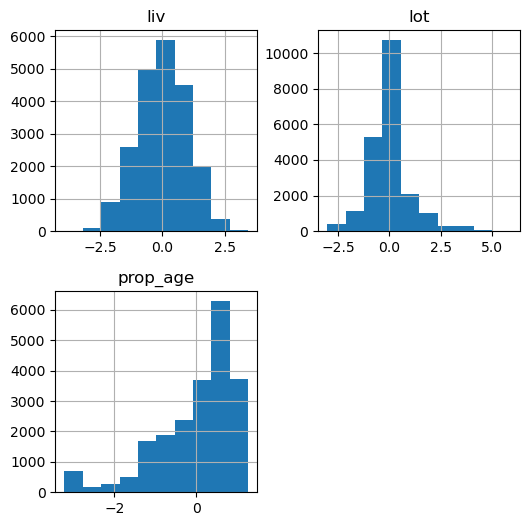

In [71]:
# standardization scaling

logsqft_living = data_log['logsqft_living'] 
logsqft_lot = data_log['logsqft_lot'] 
logproperty_age = data_log['logproperty_age'] 

living_disp = (logsqft_living - np.mean(logsqft_living)) / np.sqrt(np.var(logsqft_living))

lot_disp = (logsqft_lot - np.mean(logsqft_lot)) / np.sqrt(np.var(logsqft_lot))

property_age_disp = (logproperty_age - np.mean(logproperty_age)) / np.sqrt(np.var(logproperty_age))


data_cont_scaled = pd.DataFrame([])
data_cont_scaled['liv'] = living_disp
data_cont_scaled['lot'] = lot_disp
data_cont_scaled['prop_age'] = property_age_disp

data_cont_scaled.hist(figsize = [6, 6]);

In [72]:
data_cont_scaled

,liv,lot,prop_age
0,-1.126982,-0.383091,0.639908
1,0.747002,-0.106615,0.702046
2,-2.154696,0.252773,0.951734
3,0.094660,-0.519209,0.463982
4,-0.276459,0.015332,-0.066129
...,...,...,...
21346,-0.501624,-2.174592,-1.698064
21347,0.490221,-0.351415,-3.222647
21348,-1.477784,-1.977458,-1.698064
21349,-0.393922,-1.342238,-0.951177


In [73]:
data_reset

,price,sqft_living,sqft_lot,waterfront,property_age,has_basement,bed_2,bed_3,bed_4,bed_5,...,city_Medina,city_Mercer Island,city_North Bend,city_Redmond,city_Renton,city_Sammamish,city_Seattle,city_Snoqualmie,city_Vashon,city_Woodinville
0,221900,1180,5650,0.0,59,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
1,538000,2570,7242,0.0,63,1,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
2,180000,770,10000,0.0,82,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,604000,1960,5000,0.0,49,1,0,0,1,0,...,0,0,0,0,0,0,1,0,0,0
4,510000,1680,8080,0.0,28,0,0,1,0,0,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21346,360000,1530,1131,0.0,5,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
21347,400000,2310,5813,0.0,1,0,0,0,1,0,...,0,0,0,0,0,0,1,0,0,0
21348,402101,1020,1350,0.0,5,0,1,0,0,0,...,0,0,0,0,0,0,1,0,0,0
21349,400000,1600,2388,0.0,11,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [74]:
# Now we can drop old values and replace them with the log transformed values

data_reset.drop(['sqft_living', 'sqft_lot','property_age'], axis = 1, inplace = True)

In [75]:
# Adding log transormed values back to the model

data_fin = pd.concat([data_reset, data_cont_scaled], axis = 1)

In [76]:
data_fin.head()

,price,waterfront,has_basement,bed_2,bed_3,bed_4,bed_5,bed_6,bath_0.75,bath_1.0,...,city_Redmond,city_Renton,city_Sammamish,city_Seattle,city_Snoqualmie,city_Vashon,city_Woodinville,liv,lot,prop_age
0,221900,0.0,0,0,1,0,0,0,0,1,...,0,0,0,1,0,0,0,-1.126982,-0.383091,0.639908
1,538000,0.0,1,0,1,0,0,0,0,0,...,0,0,0,1,0,0,0,0.747002,-0.106615,0.702046
2,180000,0.0,0,1,0,0,0,0,0,1,...,0,0,0,0,0,0,0,-2.154696,0.252773,0.951734
3,604000,0.0,1,0,0,1,0,0,0,0,...,0,0,0,1,0,0,0,0.094660,-0.519209,0.463982
4,510000,0.0,0,0,1,0,0,0,0,0,...,0,0,1,0,0,0,0,-0.276459,0.015332,-0.066129


In [77]:
features_iteration_2 = data_fin.drop(['price'], axis = 1)
features_iteration_2.head()

,waterfront,has_basement,bed_2,bed_3,bed_4,bed_5,bed_6,bath_0.75,bath_1.0,bath_1.25,...,city_Redmond,city_Renton,city_Sammamish,city_Seattle,city_Snoqualmie,city_Vashon,city_Woodinville,liv,lot,prop_age
0,0.0,0,0,1,0,0,0,0,1,0,...,0,0,0,1,0,0,0,-1.126982,-0.383091,0.639908
1,0.0,1,0,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0.747002,-0.106615,0.702046
2,0.0,0,1,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,-2.154696,0.252773,0.951734
3,0.0,1,0,0,1,0,0,0,0,0,...,0,0,0,1,0,0,0,0.094660,-0.519209,0.463982
4,0.0,0,0,1,0,0,0,0,0,0,...,0,0,1,0,0,0,0,-0.276459,0.015332,-0.066129


In [78]:
predictor_iteration_2 = data_fin['price']
predictor_iteration_2.head()

0    221900
1    538000
2    180000
3    604000
4    510000
Name: price, dtype: int64

In [79]:
# Building second OLS model. 

import statsmodels.api as sm


X_2 = features_iteration_2
y_2 = predictor_iteration_2


X_2 = sm.add_constant(X_2)


model = sm.OLS(y_2, X_2).fit()


print(model.summary())


# Great, after implementing dummies and log transformation our R-squared increased. We will be working withindividual features moving forward

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.725
Model:                            OLS   Adj. R-squared:                  0.724
Method:                 Least Squares   F-statistic:                     837.4
Date:                Mon, 13 May 2024   Prob (F-statistic):               0.00
Time:                        19:03:26   Log-Likelihood:            -2.8780e+05
No. Observations:               21351   AIC:                         5.757e+05
Df Residuals:                   21283   BIC:                         5.763e+05
Df Model:                          67                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const               3.442e+05   1.98

In [80]:
# Now we will start dropping some variables that have P value highr than 0.05 (whihc mean the feature is not significant) and will see how the model is changed
# We will start with the higest P value in each category. We can also remove bath_0.75 and bath_1 since we belive those metrics are not going to bring value to the model
data_fin.drop(['has_basement', 'bath_1.25', 'floor_3.5', 'grade_9', 'cond_2', 'city_Kent', 'bath_0.75','bath_1.0' ], axis = 1, inplace = True)

In [81]:
features_iteration_3 = data_fin.drop(['price'], axis = 1)
features_iteration_3.head()

,waterfront,bed_2,bed_3,bed_4,bed_5,bed_6,bath_1.5,bath_1.75,bath_2.0,bath_2.25,...,city_Redmond,city_Renton,city_Sammamish,city_Seattle,city_Snoqualmie,city_Vashon,city_Woodinville,liv,lot,prop_age
0,0.0,0,1,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,-1.126982,-0.383091,0.639908
1,0.0,0,1,0,0,0,0,0,0,1,...,0,0,0,1,0,0,0,0.747002,-0.106615,0.702046
2,0.0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,-2.154696,0.252773,0.951734
3,0.0,0,0,1,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0.094660,-0.519209,0.463982
4,0.0,0,1,0,0,0,0,0,1,0,...,0,0,1,0,0,0,0,-0.276459,0.015332,-0.066129


In [82]:
predictor_iteration_3 = data_fin['price']
predictor_iteration_3.head()

0    221900
1    538000
2    180000
3    604000
4    510000
Name: price, dtype: int64

In [83]:
# Building third OLS model. 

import statsmodels.api as sm


X_3 = features_iteration_3
y_3 = predictor_iteration_3


X_3 = sm.add_constant(X_3)


model = sm.OLS(y_3, X_3).fit()


print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.725
Model:                            OLS   Adj. R-squared:                  0.724
Method:                 Least Squares   F-statistic:                     950.5
Date:                Mon, 13 May 2024   Prob (F-statistic):               0.00
Time:                        19:03:26   Log-Likelihood:            -2.8780e+05
No. Observations:               21351   AIC:                         5.757e+05
Df Residuals:                   21291   BIC:                         5.762e+05
Df Model:                          59                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                5.28e+05   1.92

In [84]:
# Three more feuatures to be removed: bed_2 (since P-value is close to 0.05 and bath_2.75)
data_fin.drop(['bed_2', 'bath_2.75', 'cond_3'], axis = 1, inplace = True)


In [85]:
features_iteration_4 = data_fin.drop(['price'], axis = 1)
features_iteration_4.head()

,waterfront,bed_3,bed_4,bed_5,bed_6,bath_1.5,bath_1.75,bath_2.0,bath_2.25,bath_2.5,...,city_Redmond,city_Renton,city_Sammamish,city_Seattle,city_Snoqualmie,city_Vashon,city_Woodinville,liv,lot,prop_age
0,0.0,1,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,-1.126982,-0.383091,0.639908
1,0.0,1,0,0,0,0,0,0,1,0,...,0,0,0,1,0,0,0,0.747002,-0.106615,0.702046
2,0.0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,-2.154696,0.252773,0.951734
3,0.0,0,1,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0.094660,-0.519209,0.463982
4,0.0,1,0,0,0,0,0,1,0,0,...,0,0,1,0,0,0,0,-0.276459,0.015332,-0.066129


In [86]:
predictor_iteration_4 = data_fin['price']
predictor_iteration_4.head()

0    221900
1    538000
2    180000
3    604000
4    510000
Name: price, dtype: int64

In [87]:
# Building forth OLS model. 

import statsmodels.api as sm


X_4 = features_iteration_4
y_4 = predictor_iteration_4


X_4 = sm.add_constant(X_4)


model = sm.OLS(y_4, X_4).fit()


print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.725
Model:                            OLS   Adj. R-squared:                  0.724
Method:                 Least Squares   F-statistic:                     1001.
Date:                Mon, 13 May 2024   Prob (F-statistic):               0.00
Time:                        19:03:26   Log-Likelihood:            -2.8780e+05
No. Observations:               21351   AIC:                         5.757e+05
Df Residuals:                   21294   BIC:                         5.762e+05
Df Model:                          56                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const               5.195e+05   7511

In [88]:
predictor_iteration_4_columns = data_fin.columns
predictor_iteration_4_columns

Index(['price', 'waterfront', 'bed_3', 'bed_4', 'bed_5', 'bed_6', 'bath_1.5',
       'bath_1.75', 'bath_2.0', 'bath_2.25', 'bath_2.5', 'bath_3.0',
       'bath_3.25', 'bath_3.5', 'bath_3.75', 'bath_4.0', 'bath_4.25',
       'floor_1.5', 'floor_2.0', 'floor_2.5', 'floor_3.0', 'grade_4',
       'grade_5', 'grade_6', 'grade_7', 'grade_8', 'grade_10', 'grade_11',
       'grade_12', 'grade_13', 'cond_4', 'cond_5', 'city_Bellevue',
       'city_Black Diamond', 'city_Bothell', 'city_Carnation', 'city_Duvall',
       'city_Enumclaw', 'city_Fall City', 'city_Federal Way', 'city_Issaquah',
       'city_Kenmore', 'city_Kirkland', 'city_Maple Valley', 'city_Medina',
       'city_Mercer Island', 'city_North Bend', 'city_Redmond', 'city_Renton',
       'city_Sammamish', 'city_Seattle', 'city_Snoqualmie', 'city_Vashon',
       'city_Woodinville', 'liv', 'lot', 'prop_age'],
      dtype='object')

In [89]:
# Definaning features for VIF score

X_vif = data_fin[[ 'waterfront', 'bed_3', 'bed_4', 'bed_5', 'bed_6', 'bath_1.5',
       'bath_1.75', 'bath_2.0', 'bath_2.25', 'bath_2.5', 'bath_3.0',
       'bath_3.25', 'bath_3.5', 'bath_3.75', 'bath_4.0', 'bath_4.25',
       'floor_1.5', 'floor_2.0', 'floor_2.5', 'floor_3.0', 'grade_4',
       'grade_5', 'grade_6', 'grade_7', 'grade_8', 'grade_10', 'grade_11',
       'grade_12', 'grade_13', 'cond_4', 'cond_5', 'city_Bellevue',
       'city_Black Diamond', 'city_Bothell', 'city_Carnation', 'city_Duvall',
       'city_Enumclaw', 'city_Fall City', 'city_Federal Way', 'city_Issaquah',
       'city_Kenmore', 'city_Kirkland', 'city_Maple Valley', 'city_Medina',
       'city_Mercer Island', 'city_North Bend', 'city_Redmond', 'city_Renton',
       'city_Sammamish', 'city_Seattle', 'city_Snoqualmie', 'city_Vashon',
       'city_Woodinville', 'liv', 'lot', 'prop_age']]
X_vif


,waterfront,bed_3,bed_4,bed_5,bed_6,bath_1.5,bath_1.75,bath_2.0,bath_2.25,bath_2.5,...,city_Redmond,city_Renton,city_Sammamish,city_Seattle,city_Snoqualmie,city_Vashon,city_Woodinville,liv,lot,prop_age
0,0.0,1,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,-1.126982,-0.383091,0.639908
1,0.0,1,0,0,0,0,0,0,1,0,...,0,0,0,1,0,0,0,0.747002,-0.106615,0.702046
2,0.0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,-2.154696,0.252773,0.951734
3,0.0,0,1,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0.094660,-0.519209,0.463982
4,0.0,1,0,0,0,0,0,1,0,0,...,0,0,1,0,0,0,0,-0.276459,0.015332,-0.066129
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21346,0.0,1,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0,0,-0.501624,-2.174592,-1.698064
21347,0.0,0,1,0,0,0,0,0,0,1,...,0,0,0,1,0,0,0,0.490221,-0.351415,-3.222647
21348,0.0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,-1.477784,-1.977458,-1.698064
21349,0.0,1,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,-0.393922,-1.342238,-0.951177


In [90]:
# The Variance Inflation Factor (VIF)  considered to be good if less than 5. In out case grade_7 has VIF score of 5.60 - not ideall, and suggests some level of multicollinearity, but it is not necessarily "bad." 
# It indicates that there is some correlation between this predictor and others in our model, which may inflate the variance of the associated regression coefficient. 

from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif['Features'] = X_vif.columns
vif['VIF'] = [variance_inflation_factor(X_vif.values, i) for i in range(X_vif.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
23,grade_7,5.60
1,bed_3,4.68
2,bed_4,4.58
49,city_Seattle,4.24
53,liv,4.07
17,floor_2.0,3.53
9,bath_2.5,3.37
24,grade_8,3.15
22,grade_6,2.56
55,prop_age,2.30


In [91]:
# The RMSE and MAE being significantly less than the standard deviation suggests that while the model's predictions are not extremely close to the actual values. 
# They are reasonable given the large variability in property prices. This can be somewhat reassuring in a highly variable market.
# RMSE on Train data is slightly higher than RMSE on Test data (within 10% bracket), which excludes the case of our model being overfitted 


df = pd.DataFrame(data_fin)

# Splitting the dataset into training and testing sets
X = df.drop(['price'], axis=1)  # Features (independent variables)
y = df['price']      # Target variable (dependent variable)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Creating and training the Linear Regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Making predictions
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

# Calculating MSE, RMSE, and MAE for the training set
mse_train = mean_squared_error(y_train, y_train_pred)
rmse_train = np.sqrt(mse_train)
mae_train = mean_absolute_error(y_train, y_train_pred)

# Calculating MSE, RMSE, and MAE for the test set
mse_test = mean_squared_error(y_test, y_test_pred)
rmse_test = np.sqrt(mse_test)
mae_test = mean_absolute_error(y_test, y_test_pred)

# Printing the results
print("Training Data Metrics:")
print("MSE:", mse_train)
print("RMSE:", rmse_train)
print("MAE:", mae_train)

print("\nTest Data Metrics:")
print("MSE:", mse_test)
print("RMSE:", rmse_test)
print("MAE:", mae_test)





Training Data Metrics:
MSE: 31075912377.38278
RMSE: 176283.61346813486
MAE: 115223.00707397386

Test Data Metrics:
MSE: 25481386575.611668
RMSE: 159628.9026950059
MAE: 110731.4216906077


In [92]:
data_fin.describe()

,price,waterfront,bed_3,bed_4,bed_5,bed_6,bath_1.5,bath_1.75,bath_2.0,bath_2.25,...,city_Redmond,city_Renton,city_Sammamish,city_Seattle,city_Snoqualmie,city_Vashon,city_Woodinville,liv,lot,prop_age
count,2.135100e+04,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,...,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,2.135100e+04,2.135100e+04,2.135100e+04
mean,5.291767e+05,0.006182,0.459744,0.319563,0.071519,0.010913,0.067491,0.142663,0.090300,0.095686,...,0.045244,0.074329,0.036860,0.416093,0.014238,0.005480,0.021732,-2.137851e-15,1.054283e-15,4.685702e-16
std,3.296495e+05,0.078387,0.498389,0.466318,0.257696,0.103895,0.250876,0.349737,0.286618,0.294168,...,0.207843,0.262312,0.188423,0.492921,0.118474,0.073825,0.145811,1.000023e+00,1.000023e+00,1.000023e+00
min,7.800000e+04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-3.919128e+00,-3.039995e+00,-3.222647e+00
25%,3.200000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-6.812498e-01,-5.116610e-01,-4.846663e-01
50%,4.500000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.980912e-02,-5.434316e-02,2.717411e-01
75%,6.373750e+05,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,6.997012e-01,3.160393e-01,7.020462e-01
max,4.490000e+06,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.435243e+00,5.940356e+00,1.272115e+00


In [93]:
# Replacing '.' and " " in our feature names

data_fin.columns
col_renames = {}
for col in data_fin.columns:
    if "." in col or " " in col:
        col_renames[col] = col.replace(".", "_").replace(" ", "_")
data_fin_renamed = data_fin.rename(columns=col_renames)
data_fin_renamed.columns

Index(['price', 'waterfront', 'bed_3', 'bed_4', 'bed_5', 'bed_6', 'bath_1_5',
       'bath_1_75', 'bath_2_0', 'bath_2_25', 'bath_2_5', 'bath_3_0',
       'bath_3_25', 'bath_3_5', 'bath_3_75', 'bath_4_0', 'bath_4_25',
       'floor_1_5', 'floor_2_0', 'floor_2_5', 'floor_3_0', 'grade_4',
       'grade_5', 'grade_6', 'grade_7', 'grade_8', 'grade_10', 'grade_11',
       'grade_12', 'grade_13', 'cond_4', 'cond_5', 'city_Bellevue',
       'city_Black_Diamond', 'city_Bothell', 'city_Carnation', 'city_Duvall',
       'city_Enumclaw', 'city_Fall_City', 'city_Federal_Way', 'city_Issaquah',
       'city_Kenmore', 'city_Kirkland', 'city_Maple_Valley', 'city_Medina',
       'city_Mercer_Island', 'city_North_Bend', 'city_Redmond', 'city_Renton',
       'city_Sammamish', 'city_Seattle', 'city_Snoqualmie', 'city_Vashon',
       'city_Woodinville', 'liv', 'lot', 'prop_age'],
      dtype='object')

In [94]:
# Separating features from the predictor

left_side = data_fin_renamed.columns[:1]
right_side = data_fin_renamed.columns[1:]
left_side, right_side

(Index(['price'], dtype='object'),
 Index(['waterfront', 'bed_3', 'bed_4', 'bed_5', 'bed_6', 'bath_1_5',
        'bath_1_75', 'bath_2_0', 'bath_2_25', 'bath_2_5', 'bath_3_0',
        'bath_3_25', 'bath_3_5', 'bath_3_75', 'bath_4_0', 'bath_4_25',
        'floor_1_5', 'floor_2_0', 'floor_2_5', 'floor_3_0', 'grade_4',
        'grade_5', 'grade_6', 'grade_7', 'grade_8', 'grade_10', 'grade_11',
        'grade_12', 'grade_13', 'cond_4', 'cond_5', 'city_Bellevue',
        'city_Black_Diamond', 'city_Bothell', 'city_Carnation', 'city_Duvall',
        'city_Enumclaw', 'city_Fall_City', 'city_Federal_Way', 'city_Issaquah',
        'city_Kenmore', 'city_Kirkland', 'city_Maple_Valley', 'city_Medina',
        'city_Mercer_Island', 'city_North_Bend', 'city_Redmond', 'city_Renton',
        'city_Sammamish', 'city_Seattle', 'city_Snoqualmie', 'city_Vashon',
        'city_Woodinville', 'liv', 'lot', 'prop_age'],
       dtype='object'))

In [95]:
# Adding '+' to connect features for our OLS model

left_side_str = " + ".join(left_side)
right_side_str = " + ".join(right_side)
left_side_str, right_side

('price',
 Index(['waterfront', 'bed_3', 'bed_4', 'bed_5', 'bed_6', 'bath_1_5',
        'bath_1_75', 'bath_2_0', 'bath_2_25', 'bath_2_5', 'bath_3_0',
        'bath_3_25', 'bath_3_5', 'bath_3_75', 'bath_4_0', 'bath_4_25',
        'floor_1_5', 'floor_2_0', 'floor_2_5', 'floor_3_0', 'grade_4',
        'grade_5', 'grade_6', 'grade_7', 'grade_8', 'grade_10', 'grade_11',
        'grade_12', 'grade_13', 'cond_4', 'cond_5', 'city_Bellevue',
        'city_Black_Diamond', 'city_Bothell', 'city_Carnation', 'city_Duvall',
        'city_Enumclaw', 'city_Fall_City', 'city_Federal_Way', 'city_Issaquah',
        'city_Kenmore', 'city_Kirkland', 'city_Maple_Valley', 'city_Medina',
        'city_Mercer_Island', 'city_North_Bend', 'city_Redmond', 'city_Renton',
        'city_Sammamish', 'city_Seattle', 'city_Snoqualmie', 'city_Vashon',
        'city_Woodinville', 'liv', 'lot', 'prop_age'],
       dtype='object'))

In [96]:
# Created OLS function predicotr~features

ols_input_str = " ~ ".join([left_side_str, right_side_str])
ols_input_str

'price ~ waterfront + bed_3 + bed_4 + bed_5 + bed_6 + bath_1_5 + bath_1_75 + bath_2_0 + bath_2_25 + bath_2_5 + bath_3_0 + bath_3_25 + bath_3_5 + bath_3_75 + bath_4_0 + bath_4_25 + floor_1_5 + floor_2_0 + floor_2_5 + floor_3_0 + grade_4 + grade_5 + grade_6 + grade_7 + grade_8 + grade_10 + grade_11 + grade_12 + grade_13 + cond_4 + cond_5 + city_Bellevue + city_Black_Diamond + city_Bothell + city_Carnation + city_Duvall + city_Enumclaw + city_Fall_City + city_Federal_Way + city_Issaquah + city_Kenmore + city_Kirkland + city_Maple_Valley + city_Medina + city_Mercer_Island + city_North_Bend + city_Redmond + city_Renton + city_Sammamish + city_Seattle + city_Snoqualmie + city_Vashon + city_Woodinville + liv + lot + prop_age'

In [97]:
std_results = ols(ols_input_str, 
              data=data_fin_renamed).fit()
print(std_results.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.725
Model:                            OLS   Adj. R-squared:                  0.724
Method:                 Least Squares   F-statistic:                     1001.
Date:                Mon, 13 May 2024   Prob (F-statistic):               0.00
Time:                        19:03:42   Log-Likelihood:            -2.8780e+05
No. Observations:               21351   AIC:                         5.757e+05
Df Residuals:                   21294   BIC:                         5.762e+05
Df Model:                          56                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept           5.195e+05   7511

In [98]:
print('Root mean squared error of the residuals: ', np.sqrt((std_results.resid ** 2).mean()))

Root mean squared error of the residuals:  172948.15604829357


In [99]:
data_fin.describe()

,price,waterfront,bed_3,bed_4,bed_5,bed_6,bath_1.5,bath_1.75,bath_2.0,bath_2.25,...,city_Redmond,city_Renton,city_Sammamish,city_Seattle,city_Snoqualmie,city_Vashon,city_Woodinville,liv,lot,prop_age
count,2.135100e+04,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,...,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,21351.000000,2.135100e+04,2.135100e+04,2.135100e+04
mean,5.291767e+05,0.006182,0.459744,0.319563,0.071519,0.010913,0.067491,0.142663,0.090300,0.095686,...,0.045244,0.074329,0.036860,0.416093,0.014238,0.005480,0.021732,-2.137851e-15,1.054283e-15,4.685702e-16
std,3.296495e+05,0.078387,0.498389,0.466318,0.257696,0.103895,0.250876,0.349737,0.286618,0.294168,...,0.207843,0.262312,0.188423,0.492921,0.118474,0.073825,0.145811,1.000023e+00,1.000023e+00,1.000023e+00
min,7.800000e+04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-3.919128e+00,-3.039995e+00,-3.222647e+00
25%,3.200000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-6.812498e-01,-5.116610e-01,-4.846663e-01
50%,4.500000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.980912e-02,-5.434316e-02,2.717411e-01
75%,6.373750e+05,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,6.997012e-01,3.160393e-01,7.020462e-01
max,4.490000e+06,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.435243e+00,5.940356e+00,1.272115e+00
